In [1]:
!pip install python-igraph
!pip install matplotlib
!pip install numpy
!pip install scipy
!pip install easygui
!pip install cairocffi
!pip install pm4py


Defaulting to user installation because normal site-packages is not writeable
Defaulting to user installation because normal site-packages is not writeable
Defaulting to user installation because normal site-packages is not writeable
Defaulting to user installation because normal site-packages is not writeable
Defaulting to user installation because normal site-packages is not writeable
Defaulting to user installation because normal site-packages is not writeable
Defaulting to user installation because normal site-packages is not writeable


In [1]:
import igraph as ig
import easygui
from matplotlib import pyplot as plt
import numpy as np
import scipy
import statistics
import pandas as pd
import pm4py
import matplotlib.pyplot as plt
import numpy as np
from scipy.stats import gaussian_kde

In [2]:
import pandas as pd
from igraph import Graph, plot
import matplotlib.pyplot as plt
import numpy as np

# Load data from CSV
transactions = pd.read_csv('TRANSACTION1.csv', sep=';')
securities_transactions = transactions[(transactions['FromAccountId'] != 0) | (transactions['ToAccountId'] != 0)].copy()

eventlog = pd.read_csv('eventlog.csv', sep=';')

In [3]:
#join transactions with event log
network_df = pd.merge(eventlog, securities_transactions, left_on=['TID'], right_on=['TID'], how='inner')
print(network_df)

        TID            Starttime              Endtime  \
0         1  2024-03-02 00:00:19  2024-03-02 00:00:20   
1         1  2024-03-02 00:00:20  2024-03-02 00:00:20   
2         2  2024-03-02 00:00:37  2024-03-02 00:00:38   
3         2  2024-03-02 00:00:38  2024-03-02 00:00:38   
4         5  2024-03-02 00:01:41  2024-03-02 00:01:42   
...     ...                  ...                  ...   
23715  9782  2024-03-02 21:58:43  2024-03-02 21:58:44   
23716  9783  2024-03-02 21:59:08  2024-03-02 21:59:09   
23717  9783  2024-03-02 21:59:09  2024-03-02 21:59:10   
23718  9784  2024-03-02 21:59:47  2024-03-02 21:59:48   
23719  9784  2024-03-02 21:59:48  2024-03-02 21:59:49   

                           Activity                 Time         Value  \
0                        Validating  2024-03-02 00:00:19  1.757210e+08   
1      Waiting in backlog unmatched  2024-03-02 00:00:19  1.757210e+08   
2                        Validating  2024-03-02 00:00:37  1.919393e+08   
3      Waiting in b

In [13]:
# Assuming 'network_df' contains your data
df = network_df[network_df['Activity'] == "Settling"].copy()

# # Subtract 1 from every value in the FromParticipantId and ToParticipantId columns so that Part Ids start from 0 compatible with igraph
# df['FromParticipantId'] = df['FromParticipantId'] - 1
# df['ToParticipantId'] = df['ToParticipantId'] - 1

print(df)


        TID            Starttime              Endtime  Activity  \
161      19  2024-03-02 01:30:01  2024-03-02 01:30:01  Settling   
162      78  2024-03-02 01:30:01  2024-03-02 01:30:01  Settling   
163     144  2024-03-02 01:30:01  2024-03-02 01:30:01  Settling   
258     131  2024-03-02 01:40:39  2024-03-02 01:40:39  Settling   
363     322  2024-03-02 01:54:05  2024-03-02 01:54:05  Settling   
...     ...                  ...                  ...       ...   
23370  9554  2024-03-02 19:29:09  2024-03-02 19:29:09  Settling   
23371  8075  2024-03-02 19:29:09  2024-03-02 19:29:09  Settling   
23382  9557  2024-03-02 19:29:36  2024-03-02 19:29:36  Settling   
23383  9558  2024-03-02 19:29:36  2024-03-02 19:29:36  Settling   
23386  8957  2024-03-02 19:29:43  2024-03-02 19:29:43  Settling   

                      Time         Value  FromParticipantId  FromAccountId  \
161    2024-03-02 00:12:06  2.101130e+08                  5              4   
162    2024-03-02 00:47:40  4.316207e+0

In [69]:
df.to_csv("merged.csv")

# 1 edge = 1 transaction

Participant 1 - In-degree: 173, Out-degree: 127
Participant 2 - In-degree: 54, Out-degree: 0
Participant 3 - In-degree: 135, Out-degree: 161
Participant 4 - In-degree: 179, Out-degree: 195
Participant 5 - In-degree: 128, Out-degree: 182
Participant 6 - In-degree: 258, Out-degree: 171
Participant 7 - In-degree: 285, Out-degree: 143
Participant 8 - In-degree: 180, Out-degree: 143
Participant 9 - In-degree: 38, Out-degree: 0
Participant 10 - In-degree: 181, Out-degree: 131
Participant 11 - In-degree: 201, Out-degree: 231
Participant 12 - In-degree: 185, Out-degree: 216
Participant 13 - In-degree: 238, Out-degree: 217
Participant 14 - In-degree: 197, Out-degree: 231
Participant 15 - In-degree: 212, Out-degree: 239
Participant 16 - In-degree: 202, Out-degree: 191
Participant 17 - In-degree: 155, Out-degree: 168
Participant 18 - In-degree: 0, Out-degree: 181
Participant 19 - In-degree: 201, Out-degree: 233
Participant 20 - In-degree: 175, Out-degree: 217


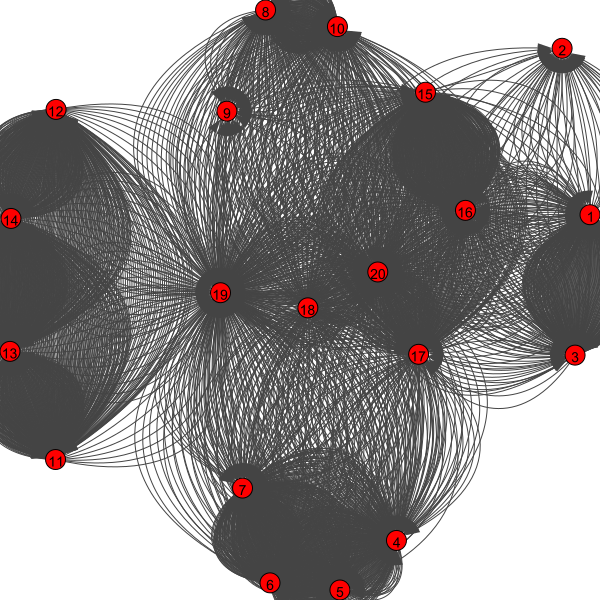

In [5]:
import pandas as pd
from igraph import Graph, plot
import matplotlib.pyplot as plt
import numpy as np

# Extract unique participant IDs
from_participants = df['FromParticipantId'].unique()
to_participants = df['ToParticipantId'].unique()
all_participants = np.unique(np.concatenate((from_participants, to_participants)))

# Create a graph with participants as nodes
g = Graph(directed=True)
g.add_vertices(all_participants.astype(str))

# Add edges for each transaction
for _, row in df.iterrows():
    g.add_edge(str(row['FromParticipantId']), str(row['ToParticipantId']))

# Calculate in-degree and out-degree for each participant
in_degree = g.indegree()
out_degree = g.outdegree()

# Print results
for v in g.vs:
    print(f"Participant {v['name']} - In-degree: {in_degree[v.index]}, Out-degree: {out_degree[v.index]}")

# Visualize the graph
layout = g.layout('kk')  # Kamada-Kawai layout
visual_style = {
    "vertex_size": 20,
    "vertex_label": g.vs['name'],
    "edge_width": [1 for _ in g.es],  # Uniform edge width as weights are not considered
    "layout": layout,
    "bbox": (600, 600),
    "margin": 10
}
plot(g, **visual_style)


In [8]:
for participant in g.vs["name"]:
    print("participant: ",participant, "Betweenness:",g.betweenness(vertices=participant), "Indegree:",g.indegree(vertices=participant), "Outdegree:",g.outdegree(vertices=participant))

participant:  18 Betweenness: 0.0 Indegree: 0 Outdegree: 10
participant:  13 Betweenness: 0.0 Indegree: 3 Outdegree: 4
participant:  8 Betweenness: 0.2222222222222222 Indegree: 5 Outdegree: 4
participant:  11 Betweenness: 0.0 Indegree: 3 Outdegree: 4
participant:  12 Betweenness: 0.0 Indegree: 3 Outdegree: 4
participant:  4 Betweenness: 0.2222222222222222 Indegree: 7 Outdegree: 5
participant:  5 Betweenness: 0.2222222222222222 Indegree: 7 Outdegree: 5
participant:  10 Betweenness: 0.2222222222222222 Indegree: 5 Outdegree: 4
participant:  3 Betweenness: 0.25 Indegree: 4 Outdegree: 5
participant:  17 Betweenness: 10.0 Indegree: 4 Outdegree: 10
participant:  19 Betweenness: 77.83333333333334 Indegree: 13 Outdegree: 10
participant:  20 Betweenness: 64.97222222222223 Indegree: 13 Outdegree: 14
participant:  15 Betweenness: 10.472222222222221 Indegree: 5 Outdegree: 7
participant:  16 Betweenness: 8.88888888888889 Indegree: 7 Outdegree: 6
participant:  14 Betweenness: 0.0 Indegree: 3 Outdegre

# edge = total value
### degree en visual klopt niet altijd zo te zien

DataFrame has been written to 'df_output.csv'
Empty DataFrame
Columns: [FromParticipantId, ToParticipantId, Value]
Index: []
Participant 18 - In-degree: 0, Out-degree: 10
Participant 13 - In-degree: 3, Out-degree: 4
Participant 8 - In-degree: 5, Out-degree: 4
Participant 11 - In-degree: 3, Out-degree: 4
Participant 12 - In-degree: 3, Out-degree: 4
Participant 4 - In-degree: 7, Out-degree: 5
Participant 5 - In-degree: 7, Out-degree: 5
Participant 10 - In-degree: 5, Out-degree: 4
Participant 3 - In-degree: 4, Out-degree: 5
Participant 17 - In-degree: 4, Out-degree: 10
Participant 19 - In-degree: 13, Out-degree: 10
Participant 20 - In-degree: 13, Out-degree: 14
Participant 15 - In-degree: 5, Out-degree: 7
Participant 16 - In-degree: 7, Out-degree: 6
Participant 14 - In-degree: 3, Out-degree: 4
Participant 7 - In-degree: 7, Out-degree: 5
Participant 1 - In-degree: 4, Out-degree: 5
Participant 6 - In-degree: 7, Out-degree: 5
Participant 9 - In-degree: 6, Out-degree: 0
Participant 2 - In-deg

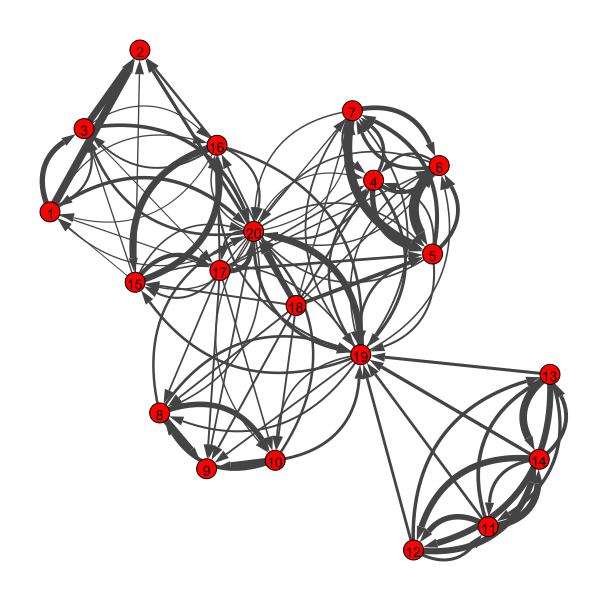

In [7]:
import pandas as pd
from igraph import Graph, plot
import numpy as np

# Load data from CSV
#transactions = pd.read_csv('testfiles\TRANSACTION1.csv', sep=';')

df = transactions[(transactions['FromAccountId'] != 0) | (transactions['ToAccountId'] != 0)].copy()

# Convert IDs to string right after filtering to maintain consistency
df['FromParticipantId'] = df['FromParticipantId'].astype(int).astype(str)
df['ToParticipantId'] = df['ToParticipantId'].astype(int).astype(str)

# Aggregate transaction values by pairs
transaction_sums = df.pivot_table(index=['FromParticipantId', 'ToParticipantId'], values='Value', aggfunc='sum').reset_index()
# Write DataFrame to a text file
transaction_sums.to_csv('df_output.csv', index=False) # Hier zit de fout niet

# Print confirmation message
print("DataFrame has been written to 'df_output.csv'")
filtered_transactions = transaction_sums[(transaction_sums['FromParticipantId'] == 18) & (transaction_sums['ToParticipantId'] == 19)]
print(filtered_transactions)
# Extract unique participant IDs and ensure they are strings
participants = pd.DataFrame({
    'id': pd.concat([df['FromParticipantId'], df['ToParticipantId']]).unique()
})

# Create a graph with participants as nodes, ensuring all are strings
g = Graph(directed=True)
g.add_vertices(participants['id'].tolist())

# Add aggregated edges, ensuring consistency in string usage
for _, row in transaction_sums.iterrows():
    try:
        if row['Value'] != 0:
            g.add_edge(row['FromParticipantId'], row['ToParticipantId'], weight=row['Value'])
    except ValueError as e:
        print(f"Error adding edge from {row['FromParticipantId']} to {row['ToParticipantId']}: {e}")

# Calculate in-degree and out-degree for each participant
in_degree = g.indegree()
out_degree = g.outdegree()

# Print results
for v in g.vs:
    print(f"Participant {v['name']} - In-degree: {in_degree[v.index]}, Out-degree: {out_degree[v.index]}")


# Normalize edge weights for visualization
weights = np.array(g.es["weight"])
normalized_weights = 1 + 9 * (weights - weights.min()) / (weights.max() - weights.min())

# Visualize the graph
layout = g.layout('kk')  # Kamada-Kawai layout
visual_style = {
    "vertex_size": 20,
    "vertex_label": g.vs['name'],
    "edge_width": normalized_weights,  # Adjust edge width scaling as needed
    "layout": layout,
    "bbox": (600, 600),
    "margin": 50
}
plot(g, **visual_style)


{18: {'in_degree': 0, 'out_degree': 10}, 13: {'in_degree': 3, 'out_degree': 4}, 8: {'in_degree': 5, 'out_degree': 4}, 11: {'in_degree': 3, 'out_degree': 4}, 12: {'in_degree': 3, 'out_degree': 4}, 4: {'in_degree': 7, 'out_degree': 5}, 5: {'in_degree': 7, 'out_degree': 5}, 10: {'in_degree': 5, 'out_degree': 4}, 3: {'in_degree': 4, 'out_degree': 5}, 17: {'in_degree': 4, 'out_degree': 10}, 19: {'in_degree': 13, 'out_degree': 10}, 20: {'in_degree': 13, 'out_degree': 14}, 15: {'in_degree': 5, 'out_degree': 7}, 16: {'in_degree': 7, 'out_degree': 6}, 14: {'in_degree': 3, 'out_degree': 4}, 7: {'in_degree': 7, 'out_degree': 5}, 1: {'in_degree': 4, 'out_degree': 5}, 6: {'in_degree': 7, 'out_degree': 5}, 9: {'in_degree': 6, 'out_degree': 0}, 2: {'in_degree': 5, 'out_degree': 0}}


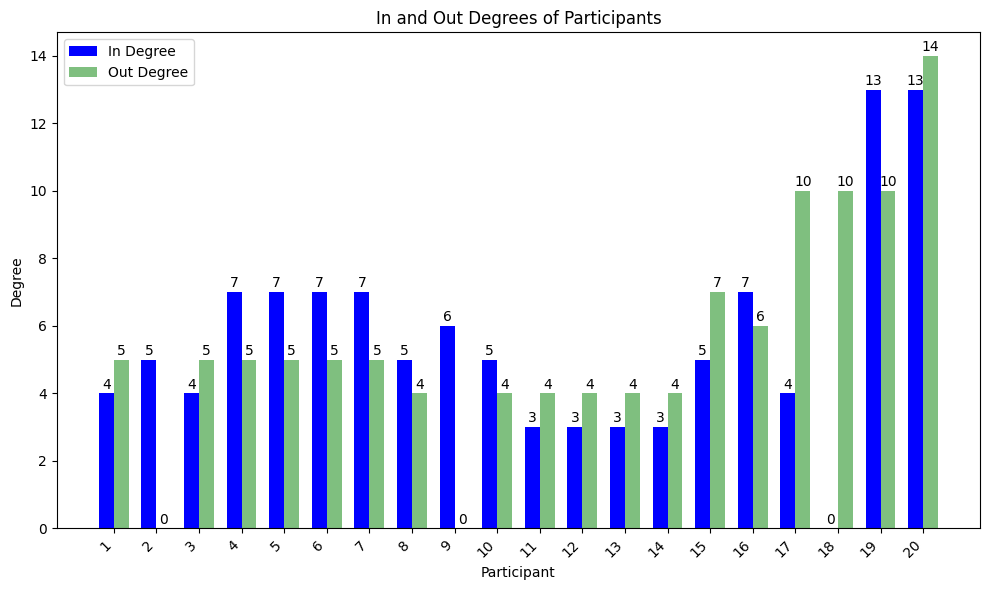

In [9]:
degree_dict={}
for participant in g.vs["name"]:
    degree_dict[int(participant)] = {}
    degree_dict[int(participant)]["in_degree"]=g.indegree(vertices=participant)
    degree_dict[int(participant)]["out_degree"]=g.outdegree(vertices=participant)
print(degree_dict)
# Extract participant names and their in and out degrees
participants = list(degree_dict.keys())
participants.sort()  # Sort the participants alphabetically
in_degrees = [degree_dict[int(participant)]["in_degree"] for participant in participants]
out_degrees = [degree_dict[int(participant)]["out_degree"] for participant in participants]

# Set the width of the bars
bar_width = 0.35

# Set the x locations for the groups
x = np.arange(len(participants))

# Plotting
plt.figure(figsize=(10, 6))
plt.bar(x - bar_width/2, in_degrees, width=bar_width, color='blue', label='In Degree')
plt.bar(x + bar_width/2, out_degrees, width=bar_width, color='green', alpha=0.5, label='Out Degree')
plt.xlabel('Participant')
plt.ylabel('Degree')
plt.title('In and Out Degrees of Participants')
plt.legend()
plt.xticks(ticks=x, labels=participants, rotation=45, ha='right')
plt.tight_layout()

# Add labels to each bar
for i, (in_degree, out_degree) in enumerate(zip(in_degrees, out_degrees)):
    plt.text(x[i] - bar_width/2, in_degree + 0.05, str(round(in_degree, 2)), ha='center', va='bottom')
    plt.text(x[i] + bar_width/2, out_degree + 0.05, str(round(out_degree, 2)), ha='center', va='bottom')

plt.show()

### Niet cumulatief, per minuut

In [15]:
import pandas as pd
from igraph import Graph, plot
import numpy as np
from PIL import Image, ImageDraw, ImageFont

# # Assuming 'network_df' contains your data
# df = network_df[network_df['Activity'] == "Settling"].copy()

# # Subtract 1 from every value in the FromParticipantId and ToParticipantId columns so that Part Ids start from 0 compatible with igraph
# df['FromParticipantId'] = df['FromParticipantId'] - 1
# df['ToParticipantId'] = df['ToParticipantId'] - 1

# Convert Starttime to datetime
df['Starttime'] = pd.to_datetime(df['Starttime'])

# Define the start and end of the day
start_day = pd.to_datetime('2024-03-02 00:00:00')
end_day = pd.to_datetime('2024-03-02 23:59:59')
test_start = pd.to_datetime('2024-03-02 01:35:00')
test_stop = pd.to_datetime('2024-03-02 01:40:00')  # Shortened range for testing

# Extract all unique participants for creating nodes
all_participants = np.unique(np.concatenate((df['FromParticipantId'].unique(), df['ToParticipantId'].unique()))).astype(str)

# Set a random seed for layout consistency
np.random.seed(1)

# Precompute the layout for all nodes (to keep positions of singletons consistent)
g_all = Graph(directed=True)
g_all.add_vertices(all_participants)
g_all.vs['name'] = all_participants
fixed_layout = g_all.layout('fr')  # Fruchterman-Reingold layout

png_counter = 1
# Loop through each minute of the day
current_time = start_day
while current_time <= end_day:
    next_time = current_time + pd.Timedelta(minutes=1) - pd.Timedelta(seconds=1)
    
    # Filter the DataFrame to keep only transactions within the current minute
    minute_df = df[(df['Starttime'] >= current_time) & (df['Starttime'] <= next_time)].copy()
    
    # Convert IDs to string after filtering to maintain consistency
    minute_df['FromParticipantId'] = minute_df['FromParticipantId'].astype(str)
    minute_df['ToParticipantId'] = minute_df['ToParticipantId'].astype(str)
    
    # Create a graph with participants as nodes
    g = Graph(directed=True)
    g.add_vertices(all_participants)
    g.vs['name'] = all_participants  # Set the name attribute for each vertex
    
    if not minute_df.empty:
        # Aggregate transaction values by pairs
        transaction_sums = minute_df.pivot_table(index=['FromParticipantId', 'ToParticipantId'], values='Value', aggfunc='sum').reset_index()
        
        # Add aggregated edges, ensuring consistency in string usage
        for _, row in transaction_sums.iterrows():
            try:
                if row['Value'] != 0:
                    g.add_edge(row['FromParticipantId'], row['ToParticipantId'], weight=row['Value'])
            except ValueError as e:
                print(f"Error adding edge from {row['FromParticipantId']} to {row['ToParticipantId']}: {e}")

        # Normalize edge weights for visualization
        weights = np.array(g.es["weight"])
        if len(weights) > 1:
            normalized_weights = 1 + 9 * (weights - weights.min()) / (weights.max() - weights.min())
        else:
            normalized_weights = []

    else:
        normalized_weights = []

    # Use the precomputed layout for visualization
    layout = fixed_layout
    
    # Visualize the graph
    visual_style = {
        "vertex_size": 20,
        "vertex_label": g.vs['name'],
        "layout": layout,
        "bbox": (1000, 1000),
        "margin": 50
    }
    if len(normalized_weights) > 0:
        visual_style["edge_width"] = normalized_weights  # Add edge widths if there are edges
    
    

    # Add title using PIL
    # Open the image
    image = Image.open(file_name)
    draw = ImageDraw.Draw(image)
    
    # Define the title text
    title_text = f"Network Graph at {current_time.strftime('%Y-%m-%d %H:%M:%S')} - {next_time.strftime('%Y-%m-%d %H:%M:%S')}"
    
    # Define font and size (adjust path to your font if necessary)
    font = ImageFont.truetype("arial.ttf", 12)
    
    # Calculate text bounding box
    text_bbox = draw.textbbox((0, 0), title_text, font=font)
    text_width = text_bbox[2] - text_bbox[0]
    text_height = text_bbox[3] - text_bbox[1]
    
    # Set text position
    text_position = ((image.width - text_width) // 2, 10)
    
    # Add text to image
    draw.text(text_position, title_text, font=font, fill="black")
    
    # Save the image with the title
    image.save(file_name)
    
    # For testing purposes, manual check
    #minute_df.to_csv(f"df_{current_time.strftime('%Y-%m-%d_%H-%M-%S')}.csv", index=False)
    
    # Print confirmation message
    #print(f"Graph for {current_time.strftime('%Y-%m-%d %H:%M:%S')} has been drawn and saved as {file_name}.")
    
    # Move to the next minute
    current_time += pd.Timedelta(minutes=1)
    png_counter += 1


NameError: name 'file_name' is not defined

### Cumulatief - per 15 minute -- in and out degree

C:\Users\toont\AppData\Local\Temp\ipykernel_20376\1380931129.py:95: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(figsize=(10, 6))


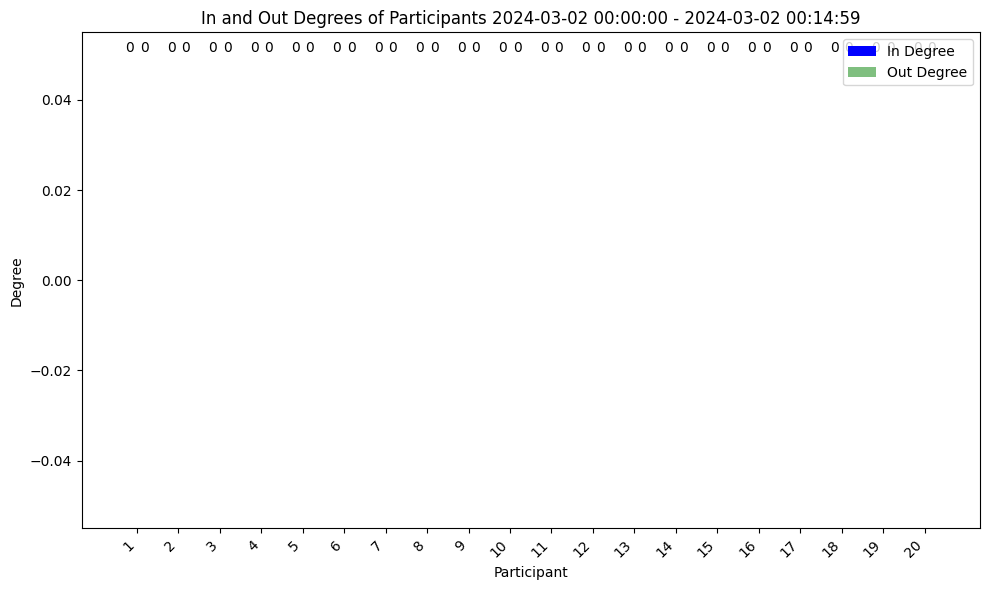

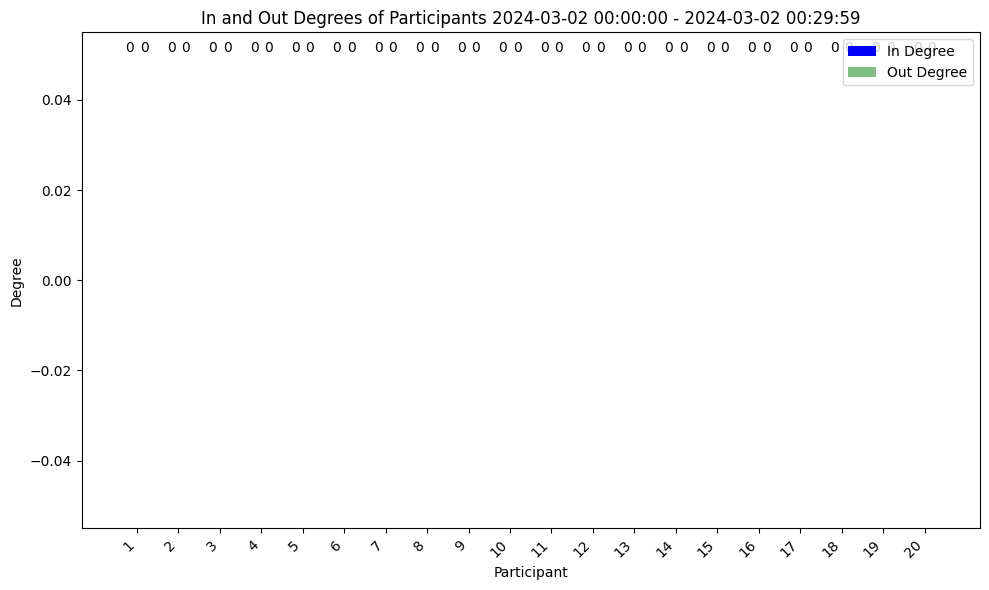

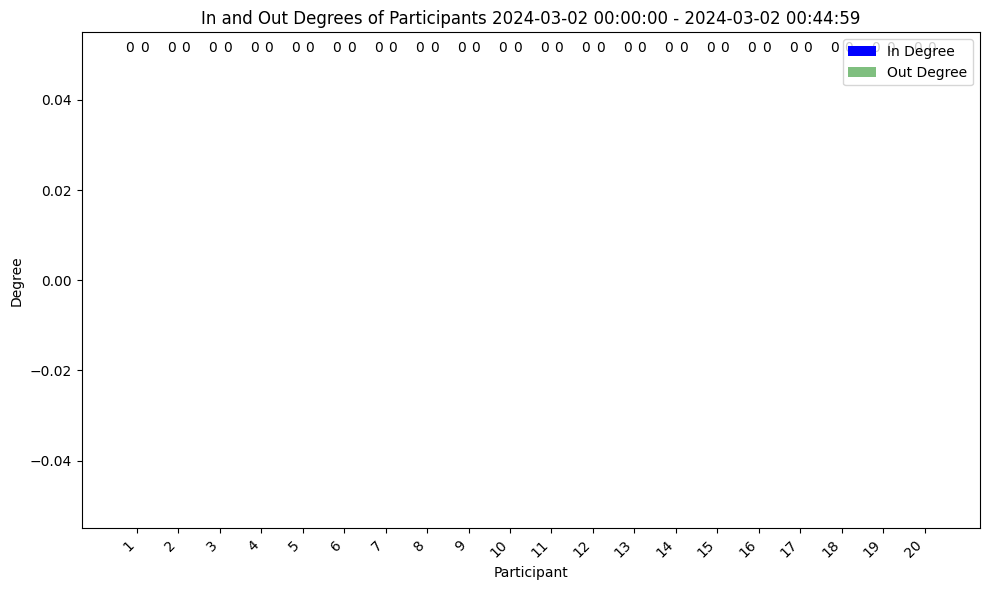

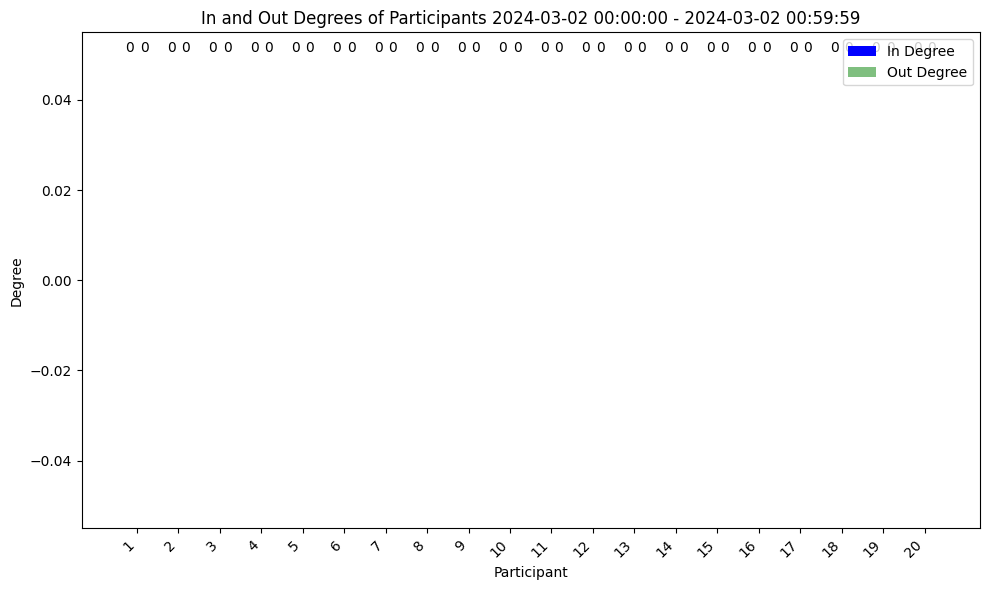

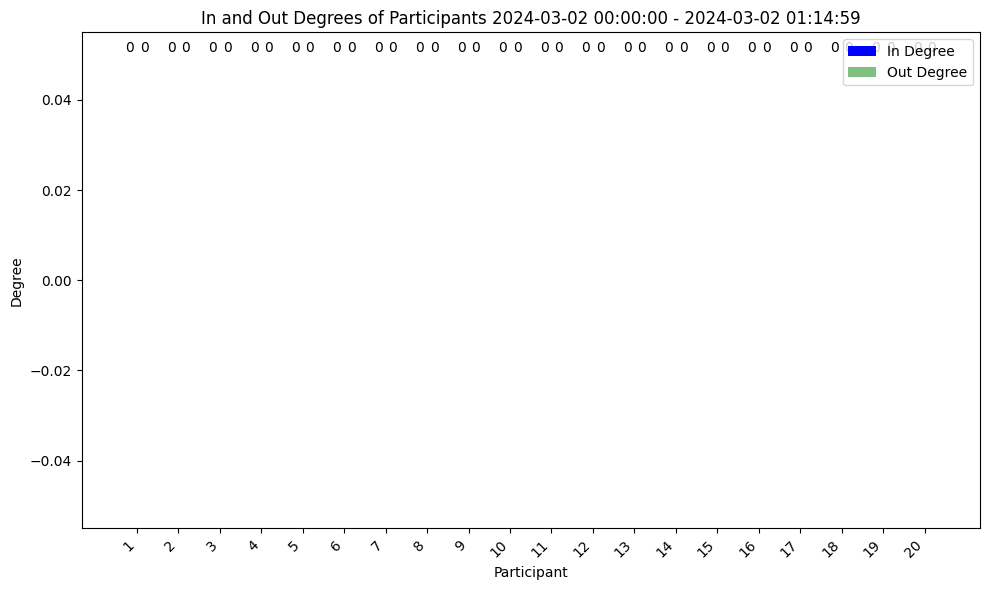

...

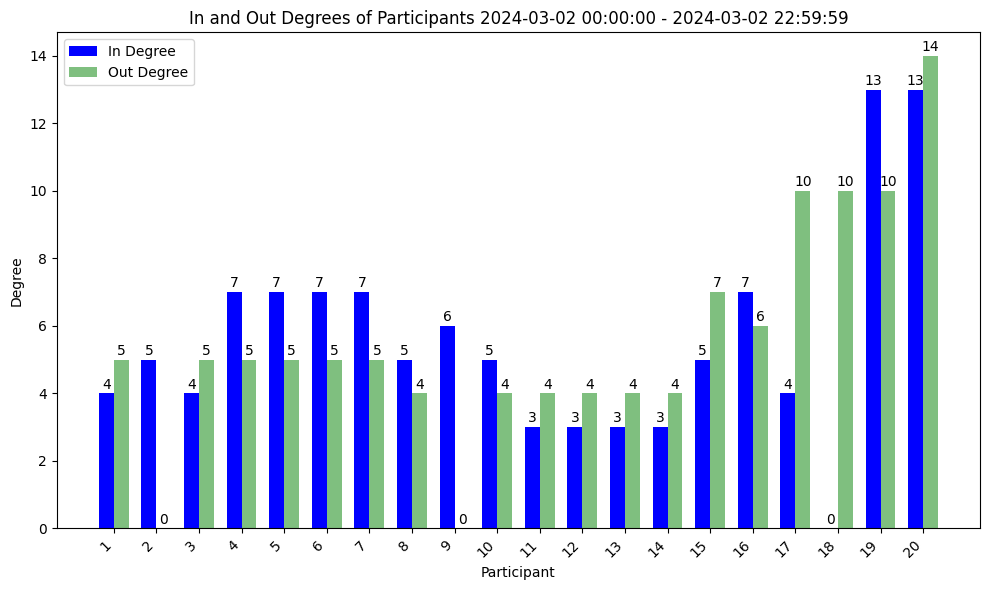

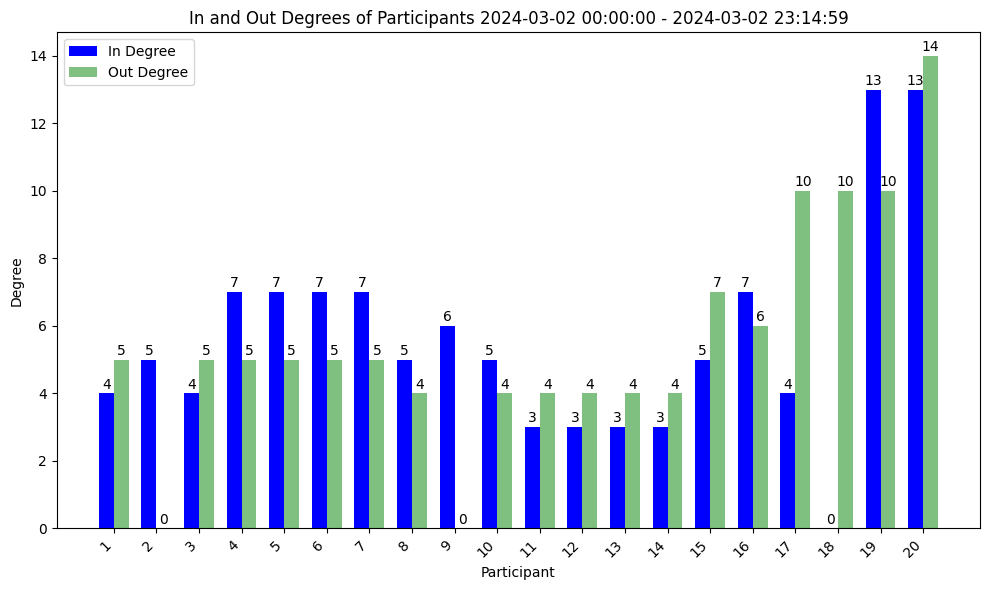

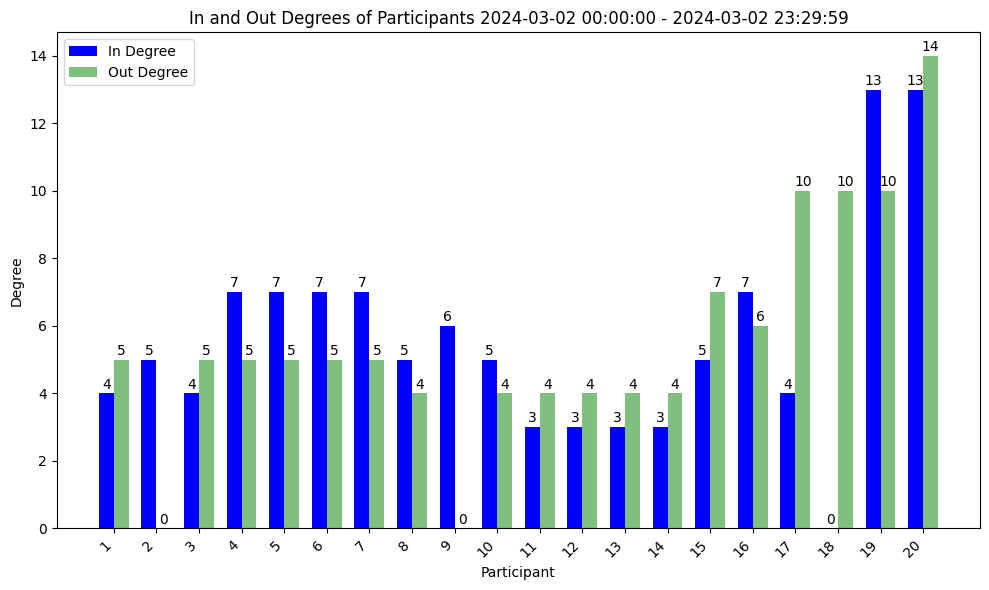

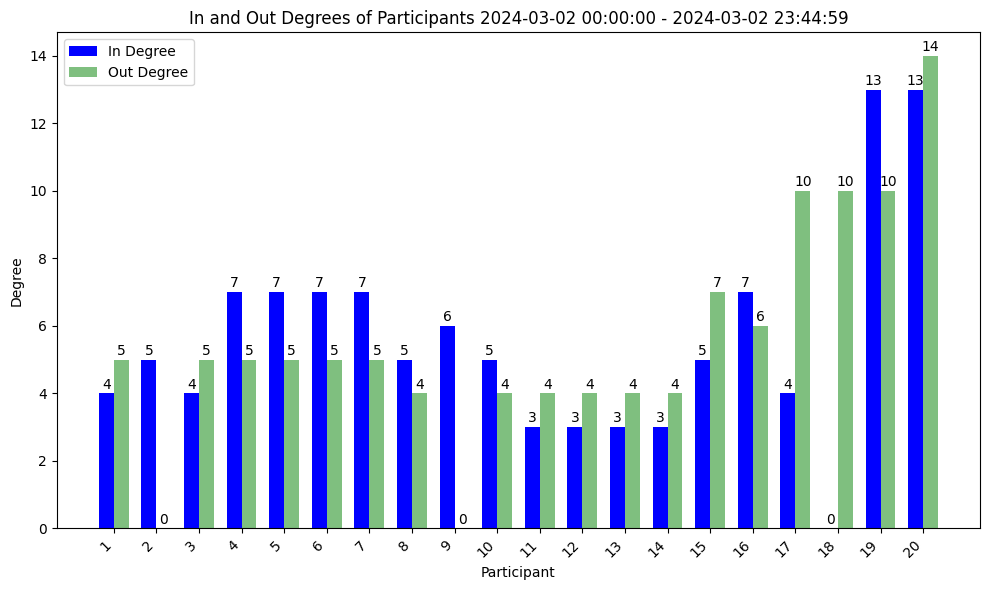

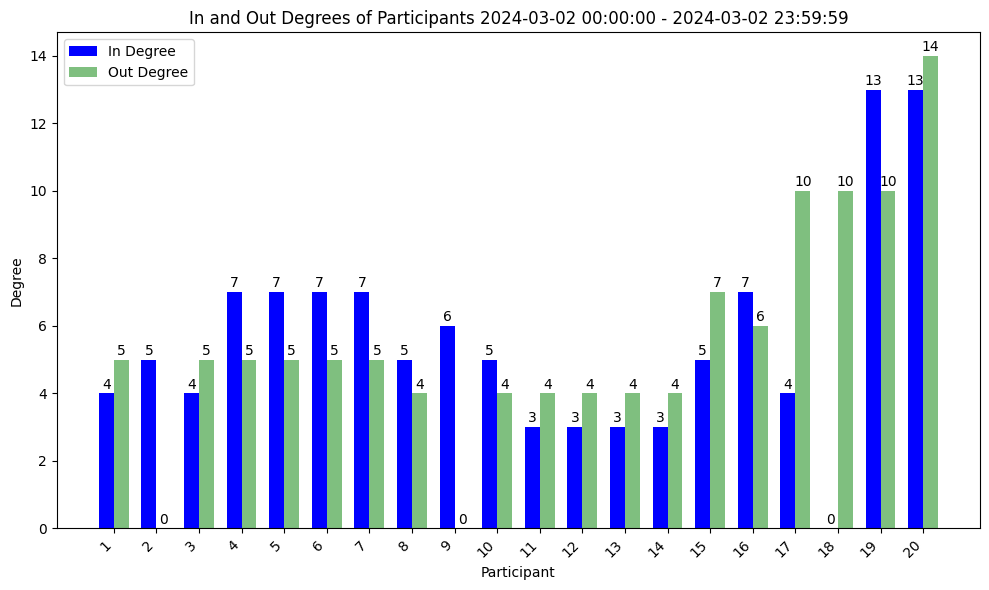

In [17]:
import pandas as pd
from igraph import Graph, plot
import numpy as np
from PIL import Image, ImageDraw, ImageFont

# Convert Starttime to datetime
df['Starttime'] = pd.to_datetime(df['Starttime'])

# Define the start and end of the day
start_day = pd.to_datetime('2024-03-02 00:00:00')
end_day = pd.to_datetime('2024-03-02 23:59:59')
test_start = pd.to_datetime('2024-03-02 01:35:00')
test_stop = pd.to_datetime('2024-03-02 01:40:00')  # Shortened range for testing
current_time = start_day

# Ensure the IDs are treated as integers and then convert to strings
minute_df['FromParticipantId'] = minute_df['FromParticipantId'].astype(int).astype(str)
minute_df['ToParticipantId'] = minute_df['ToParticipantId'].astype(int).astype(str)


# Extract all unique participants for creating nodes
all_participants = np.unique(np.concatenate((minute_df['FromParticipantId'].unique(), minute_df['ToParticipantId'].unique())))

# Set a random seed for layout consistency
np.random.seed(75)

# Create a graph with participants as nodes for layout computation
g_all = Graph(directed=True)
g_all.add_vertices(all_participants)
g_all.vs['name'] = all_participants

# Add edges from minute_df for layout computation
transaction_sums = minute_df.pivot_table(index=['FromParticipantId', 'ToParticipantId'], values='Value', aggfunc='sum').reset_index()
for _, row in transaction_sums.iterrows():
    from_id = str(row['FromParticipantId'])
    to_id = str(row['ToParticipantId'])
    if row['Value'] != 0:
        g_all.add_edge(from_id, to_id, weight=row['Value'])

# Precompute the layout for all nodes (to keep positions of singletons consistent)
fixed_layout = g_all.layout('fr')  # Fruchterman-Reingold layout

png_counter = 1
# Loop through each minute of the day
# Initialize degree dictionary with all participants and degrees set to 0
degree_dict = {int(participant): {"in_degree": 0, "out_degree": 0} for participant in all_participants}

# Loop through each minute of the day
current_time = start_day
next_time = current_time + pd.Timedelta(minutes=15) - pd.Timedelta(seconds=1)
while next_time <= end_day:
    # Filter the DataFrame to keep only transactions within the current minute
    minute_df = df[(df['Starttime'] >= current_time) & (df['Starttime'] <= next_time)].copy()

    # Convert IDs to string after filtering to maintain consistency
    minute_df['FromParticipantId'] = minute_df['FromParticipantId'].astype(str)
    minute_df['ToParticipantId'] = minute_df['ToParticipantId'].astype(str)

    # Create a graph with participants as nodes
    g = Graph(directed=True)
    g.add_vertices(all_participants)
    g.vs['name'] = all_participants  # Set the name attribute for each vertex

    if not minute_df.empty:
        # Aggregate transaction values by pairs
        transaction_sums = minute_df.pivot_table(index=['FromParticipantId', 'ToParticipantId'], values='Value', aggfunc='sum').reset_index()

        # Add aggregated edges, ensuring consistency in string usage
        for _, row in transaction_sums.iterrows():
            try:
                if row['Value'] != 0:
                    g.add_edge(row['FromParticipantId'], row['ToParticipantId'], weight=row['Value'])
            except ValueError as e:
                print(f"Error adding edge from {row['FromParticipantId']} to {row['ToParticipantId']}: {e}")

    # Update degrees in the degree dictionary
    for participant in all_participants:
        participant_id = int(participant)
        degree_dict[participant_id]["in_degree"] = g.indegree(vertices=participant)
        degree_dict[participant_id]["out_degree"] = g.outdegree(vertices=participant)

    # Extract participant names and their in and out degrees
    participants = list(degree_dict.keys())
    participants.sort()  # Sort the participants alphabetically
    in_degrees = [degree_dict[int(participant)]["in_degree"] for participant in participants]
    out_degrees = [degree_dict[int(participant)]["out_degree"] for participant in participants]


    # Set the width of the bars
    bar_width = 0.35

    # Set the x locations for the groups
    x = np.arange(len(participants))

    fig, ax = plt.subplots(figsize=(10, 6))

    # Plotting
    ax.bar(x - bar_width/2, in_degrees, width=bar_width, color='blue', label='In Degree')
    ax.bar(x + bar_width/2, out_degrees, width=bar_width, color='green', alpha=0.5, label='Out Degree')
    ax.set_xlabel('Participant')
    ax.set_ylabel('Degree')
    ax.set_title(f'In and Out Degrees of Participants {current_time.strftime('%Y-%m-%d %H:%M:%S')} - {next_time.strftime('%Y-%m-%d %H:%M:%S')}')
    ax.legend()
    ax.set_xticks(ticks=x)
    ax.set_xticklabels(participants, rotation=45, ha='right')
    plt.tight_layout()

    # Add labels to each bar
    for i, (in_degree, out_degree) in enumerate(zip(in_degrees, out_degrees)):
        ax.text(x[i] - bar_width/2, in_degree + 0.05, str(round(in_degree, 2)), ha='center', va='bottom')
        ax.text(x[i] + bar_width/2, out_degree + 0.05, str(round(out_degree, 2)), ha='center', va='bottom')

    file_name = f"video-cumulatief/graph_{png_counter}.png"
    plt.savefig(file_name)

    
    # Move to the next minute
    next_time += pd.Timedelta(minutes=15)
    png_counter += 1


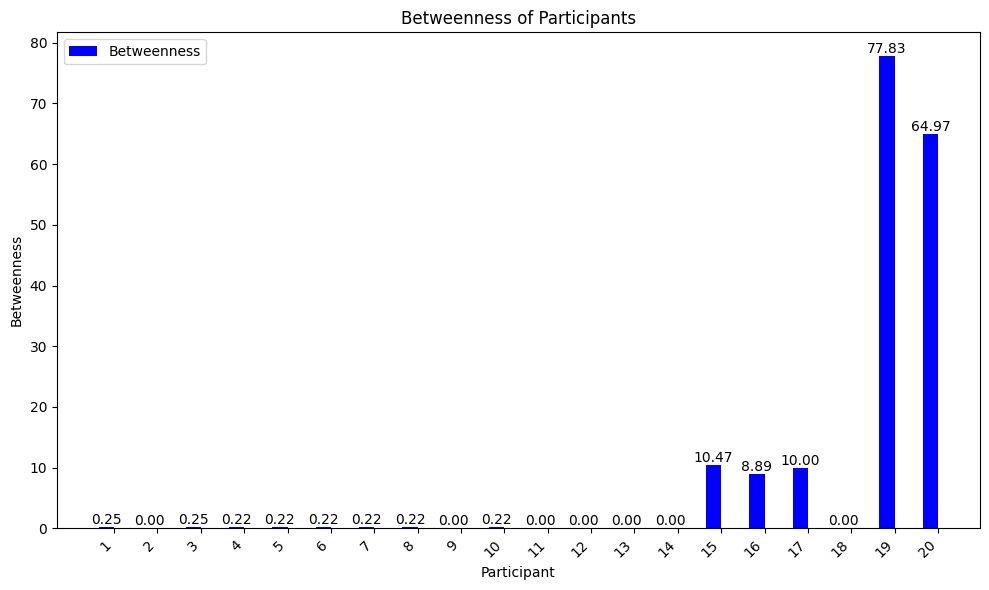

In [22]:
import matplotlib.pyplot as plt
import numpy as np

# Assuming all_participants is defined and g.betweenness() is a valid method call for your graph
# Create a dictionary to store betweenness centrality for each participant
betweenness_dict = {int(participant): {"betweenness": 0} for participant in all_participants}

# Update betweenness in the betweenness dictionary
for participant in all_participants:
    participant_id = int(participant)
    betweenness_dict[participant_id]["betweenness"] = g.betweenness(vertices=participant)

# Extract participant IDs and their betweenness values
participants = list(betweenness_dict.keys())
participants.sort()  # Sort the participants by their ID
betweenness = [betweenness_dict[participant]["betweenness"] for participant in participants]

# Set the width of the bars
bar_width = 0.35

# Set the x locations for the groups
x = np.arange(len(participants))

fig, ax = plt.subplots(figsize=(10, 6))

# Plotting the betweenness
bars = ax.bar(x - bar_width/2, betweenness, width=bar_width, color='blue', label='Betweenness')

# Add labels to the bars
for bar, value in zip(bars, betweenness):
    ax.text(bar.get_x() + bar.get_width() / 2, bar.get_height(), f'{value:.2f}', 
            ha='center', va='bottom')

# Set labels and title
ax.set_xlabel('Participant')
ax.set_ylabel('Betweenness')
ax.set_title('Betweenness of Participants')
ax.legend()

# Set x-ticks and labels
ax.set_xticks(ticks=x)
ax.set_xticklabels(participants, rotation=45, ha='right')

plt.tight_layout()
plt.show()


### Cumulative per 15 min --> betweenness per participant

C:\Users\toont\AppData\Local\Temp\ipykernel_20376\2566063668.py:99: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(figsize=(10, 6))


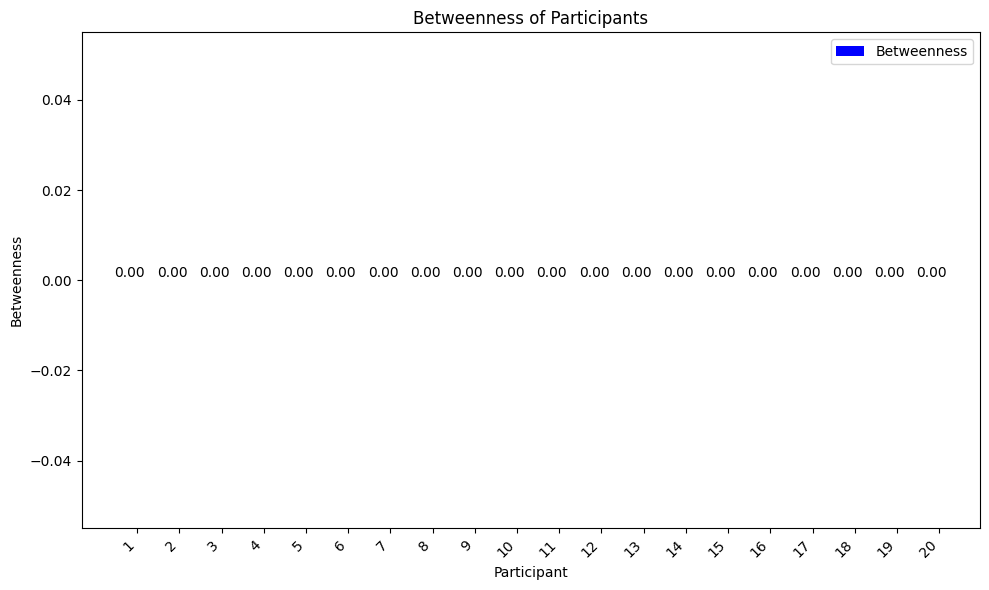

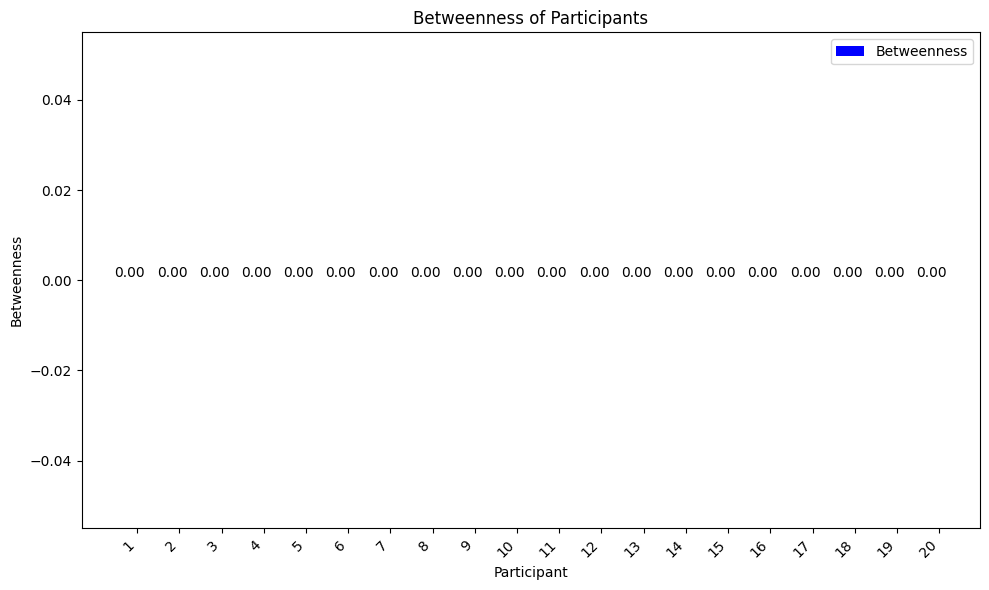

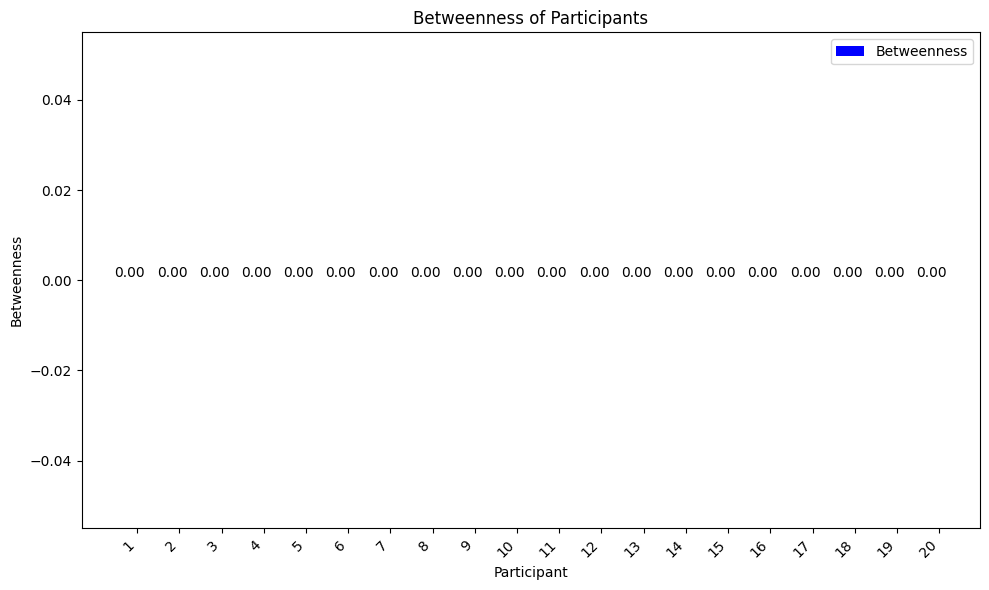

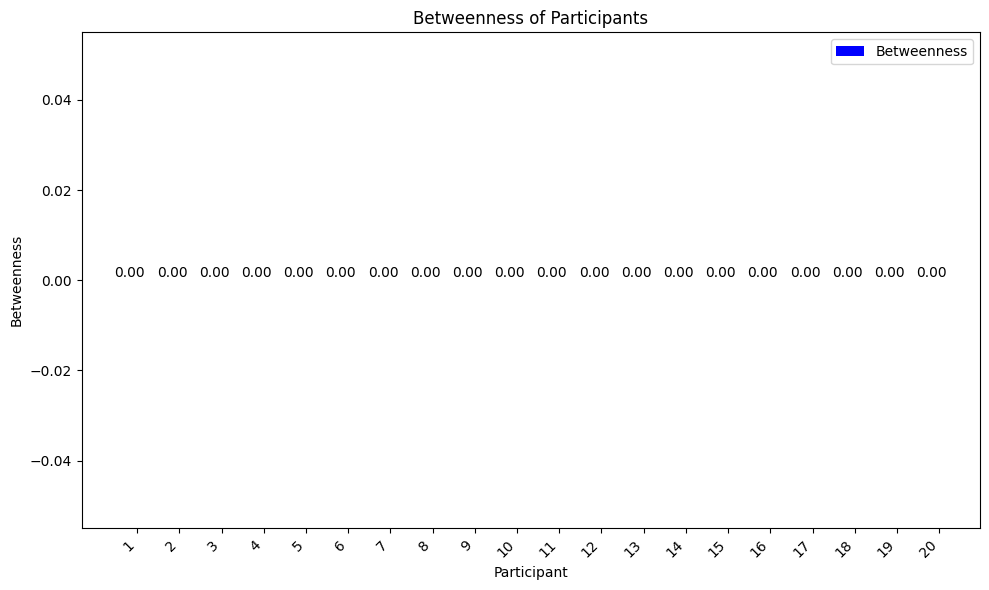

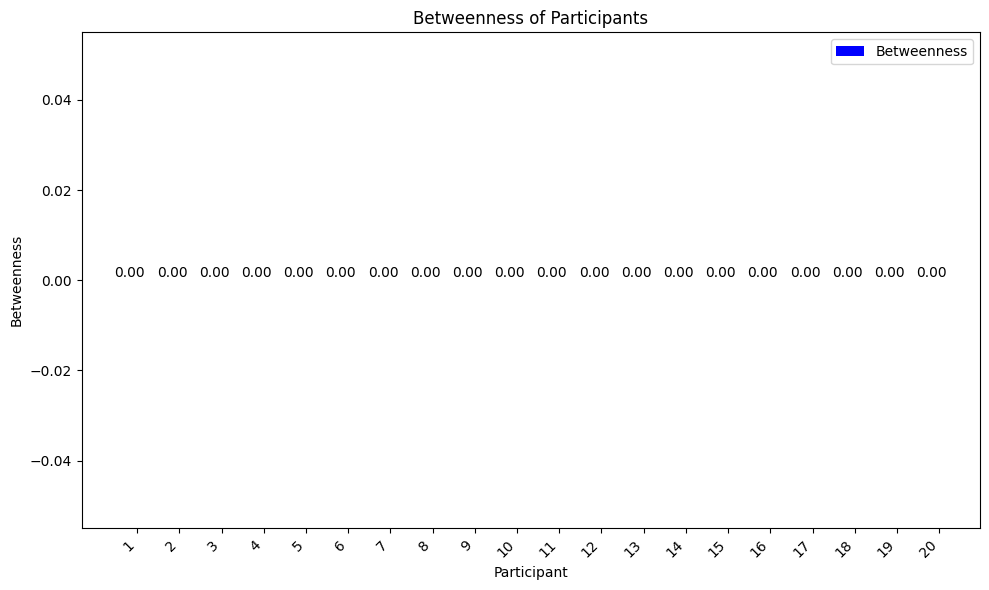

...

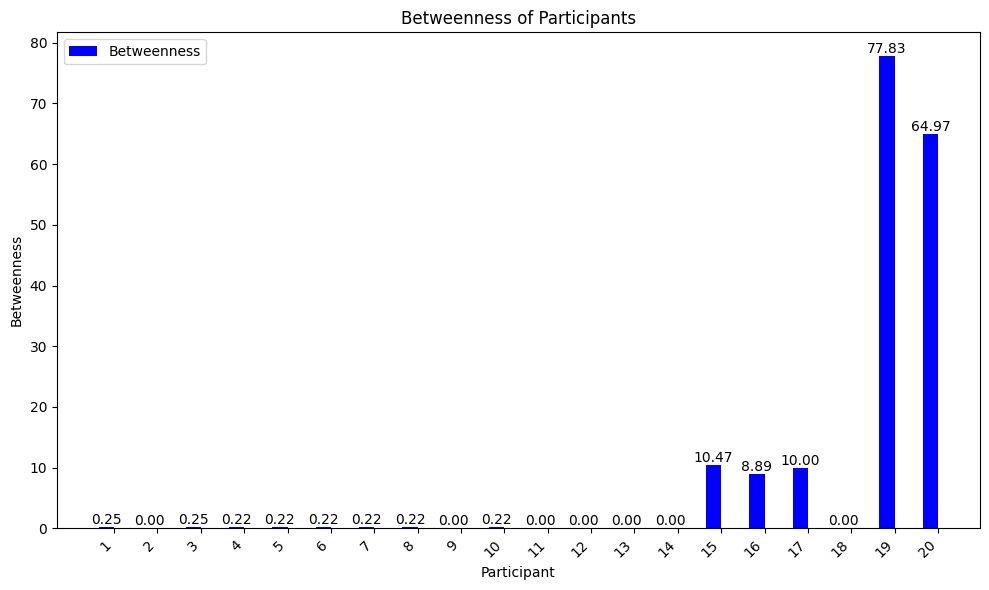

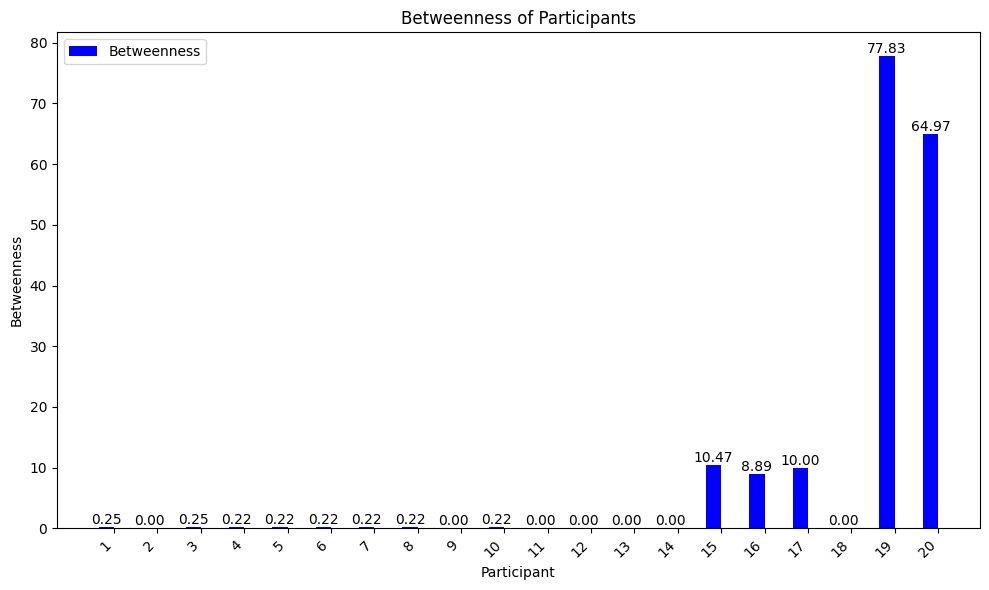

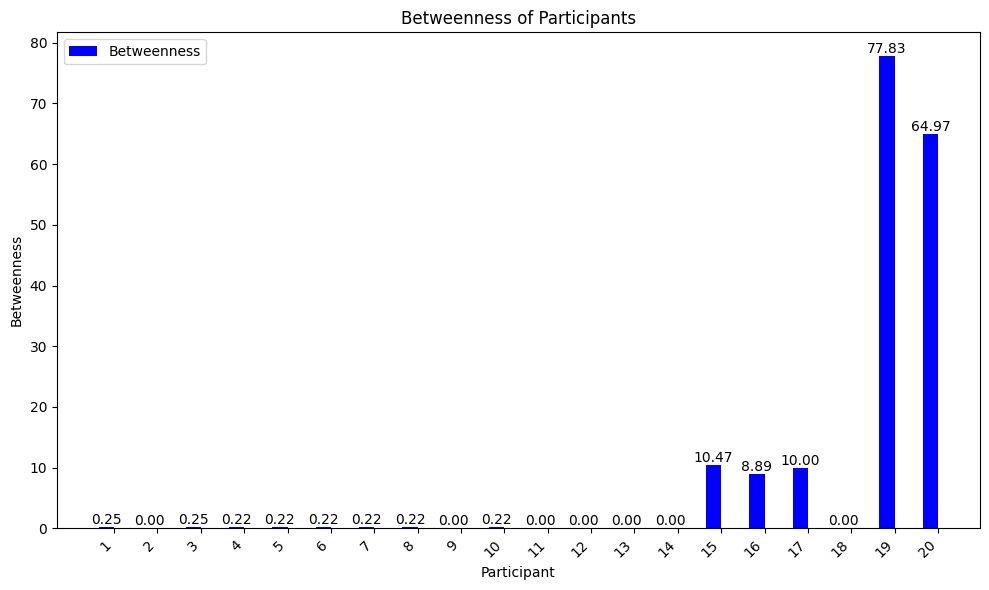

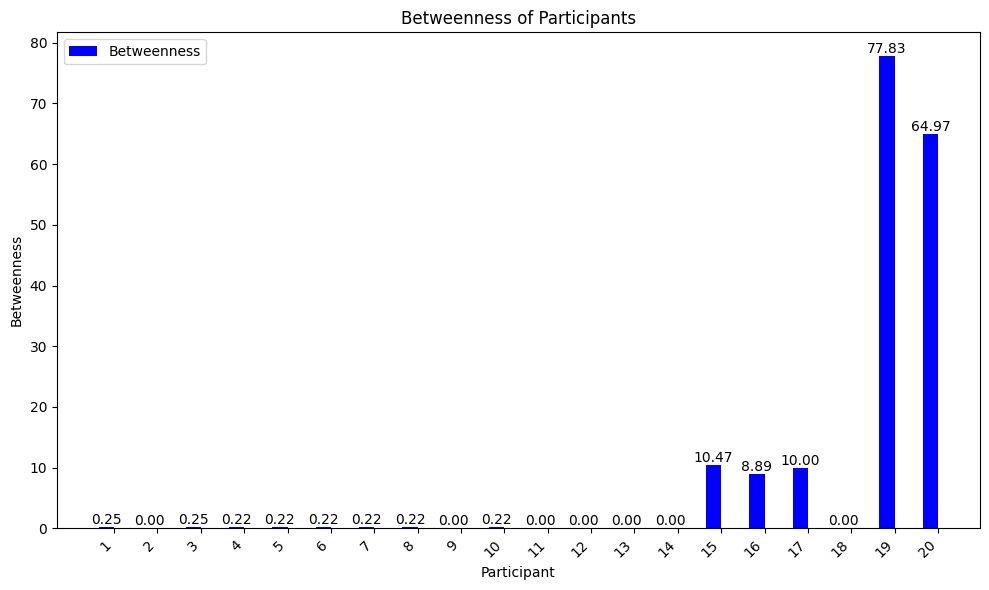

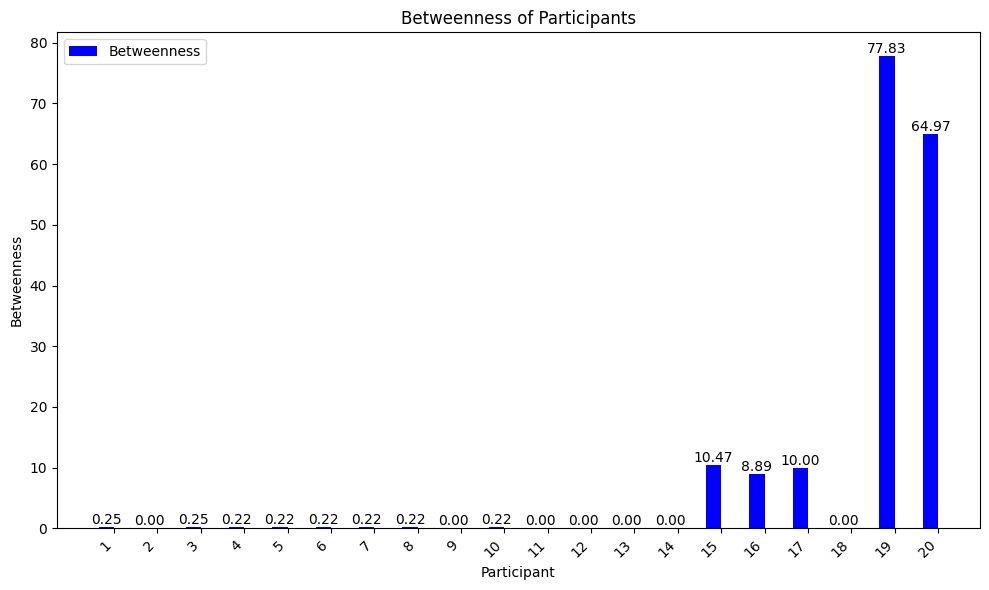

In [24]:
import pandas as pd
from igraph import Graph, plot
import numpy as np
from PIL import Image, ImageDraw, ImageFont

# Convert Starttime to datetime
df['Starttime'] = pd.to_datetime(df['Starttime'])

# Define the start and end of the day
start_day = pd.to_datetime('2024-03-02 00:00:00')
end_day = pd.to_datetime('2024-03-02 23:59:59')
test_start = pd.to_datetime('2024-03-02 01:35:00')
test_stop = pd.to_datetime('2024-03-02 01:40:00')  # Shortened range for testing
current_time = start_day

# Ensure the IDs are treated as integers and then convert to strings
minute_df['FromParticipantId'] = minute_df['FromParticipantId'].astype(int).astype(str)
minute_df['ToParticipantId'] = minute_df['ToParticipantId'].astype(int).astype(str)


# Extract all unique participants for creating nodes
all_participants = np.unique(np.concatenate((minute_df['FromParticipantId'].unique(), minute_df['ToParticipantId'].unique())))

# Set a random seed for layout consistency
np.random.seed(75)

# Create a graph with participants as nodes for layout computation
g_all = Graph(directed=True)
g_all.add_vertices(all_participants)
g_all.vs['name'] = all_participants

# Add edges from minute_df for layout computation
transaction_sums = minute_df.pivot_table(index=['FromParticipantId', 'ToParticipantId'], values='Value', aggfunc='sum').reset_index()
for _, row in transaction_sums.iterrows():
    from_id = str(row['FromParticipantId'])
    to_id = str(row['ToParticipantId'])
    if row['Value'] != 0:
        g_all.add_edge(from_id, to_id, weight=row['Value'])

# Precompute the layout for all nodes (to keep positions of singletons consistent)
fixed_layout = g_all.layout('fr')  # Fruchterman-Reingold layout

png_counter = 1
# Loop through each minute of the day
# Initialize degree dictionary with all participants and degrees set to 0
degree_dict = {int(participant): {"in_degree": 0, "out_degree": 0} for participant in all_participants}

# Loop through each minute of the day
current_time = start_day
next_time = current_time + pd.Timedelta(minutes=15) - pd.Timedelta(seconds=1)
while next_time <= end_day:
    # Filter the DataFrame to keep only transactions within the current minute
    minute_df = df[(df['Starttime'] >= current_time) & (df['Starttime'] <= next_time)].copy()

    # Convert IDs to string after filtering to maintain consistency
    minute_df['FromParticipantId'] = minute_df['FromParticipantId'].astype(str)
    minute_df['ToParticipantId'] = minute_df['ToParticipantId'].astype(str)

    # Create a graph with participants as nodes
    g = Graph(directed=True)
    g.add_vertices(all_participants)
    g.vs['name'] = all_participants  # Set the name attribute for each vertex

    if not minute_df.empty:
        # Aggregate transaction values by pairs
        transaction_sums = minute_df.pivot_table(index=['FromParticipantId', 'ToParticipantId'], values='Value', aggfunc='sum').reset_index()

        # Add aggregated edges, ensuring consistency in string usage
        for _, row in transaction_sums.iterrows():
            try:
                if row['Value'] != 0:
                    g.add_edge(row['FromParticipantId'], row['ToParticipantId'], weight=row['Value'])
            except ValueError as e:
                print(f"Error adding edge from {row['FromParticipantId']} to {row['ToParticipantId']}: {e}")

    # Update degrees in the degree dictionary


    # Assuming all_participants is defined and g.betweenness() is a valid method call for your graph
    # Create a dictionary to store betweenness centrality for each participant
    betweenness_dict = {int(participant): {"betweenness": 0} for participant in all_participants}

    # Update betweenness in the betweenness dictionary
    for participant in all_participants:
        participant_id = int(participant)
        betweenness_dict[participant_id]["betweenness"] = g.betweenness(vertices=participant)

    # Extract participant IDs and their betweenness values
    participants = list(betweenness_dict.keys())
    participants.sort()  # Sort the participants by their ID
    betweenness = [betweenness_dict[participant]["betweenness"] for participant in participants]

    # Set the width of the bars
    bar_width = 0.35

    # Set the x locations for the groups
    x = np.arange(len(participants))

    fig, ax = plt.subplots(figsize=(10, 6))

    # Plotting the betweenness
    bars = ax.bar(x - bar_width/2, betweenness, width=bar_width, color='blue', label='Betweenness')

    # Add labels to the bars
    for bar, value in zip(bars, betweenness):
        ax.text(bar.get_x() + bar.get_width() / 2, bar.get_height(), f'{value:.2f}', 
                ha='center', va='bottom')

    # Set labels and title
    ax.set_xlabel('Participant')
    ax.set_ylabel('Betweenness')
    ax.set_title('Betweenness of Participants')
    ax.legend()

    # Set x-ticks and labels
    ax.set_xticks(ticks=x)
    ax.set_xticklabels(participants, rotation=45, ha='right')

    plt.tight_layout()
 
    file_name = f"video-cumulatief/graph_{png_counter}.png"
    plt.savefig(file_name)

    
    # Move to the next minute
    next_time += pd.Timedelta(minutes=15)
    png_counter += 1


### Generate video

MovieWriter ffmpeg unavailable; using Pillow instead.


Time to load 96 images: 0.23 seconds
Time to create animation: 0.08 seconds


TypeError: AbstractMovieWriter.__init__() got an unexpected keyword argument 'extra_args'

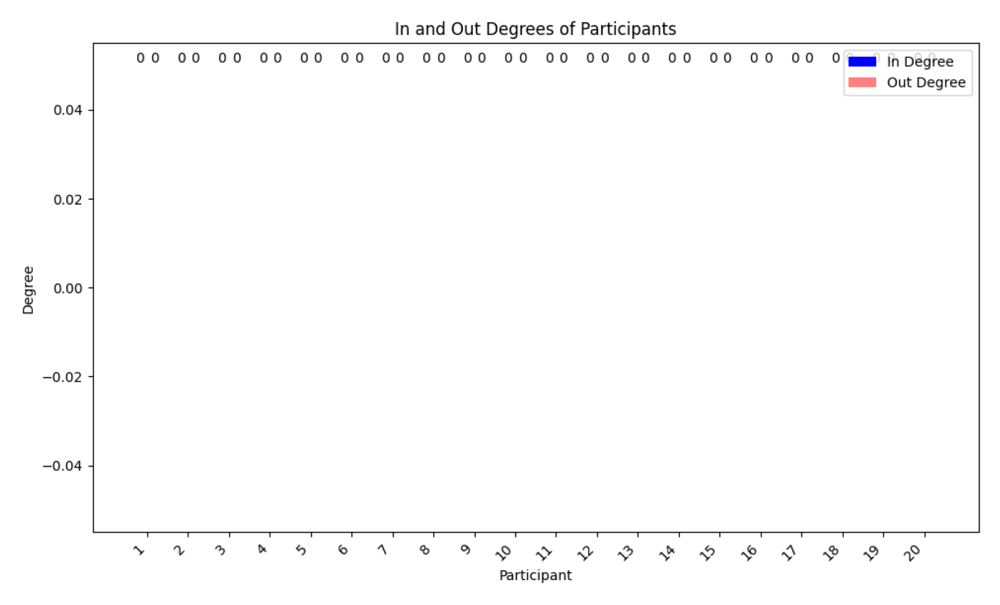

In [17]:
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
import numpy as np
from concurrent.futures import ThreadPoolExecutor
from PIL import Image
import time
import re


time_between_images = 350 # ms
png_counter = 97

# Function to load an image
def load_image(file_path):
    return np.array(Image.open(file_path))

# Get all PNG files in the directory starting from graph_1.png
image_files = [f"./video-cumulatief/graph_{i}.png" for i in range(1, png_counter)]

# Sort image files numerically
def sort_numerically(file_list):
    return sorted(file_list, key=lambda x: int(re.findall(r'\d+', x)[0]), reverse=False) # reverse order

sorted_image_files = sort_numerically(image_files)

# Measure time for loading images
start_time = time.time()
with ThreadPoolExecutor() as executor:
    images = list(executor.map(load_image, sorted_image_files))
load_time = time.time() - start_time
print(f"Time to load {png_counter-1} images: {load_time:.2f} seconds")

# Set up a Full HD resolution figure
fig, ax = plt.subplots(figsize=(19.2, 10.8), dpi=100)  # 19.2 inches * 100 dpi = 1920 pixels, 10.8 inches * 100 dpi = 1080 pixels
ax.axis('off')

# Display the first image initially
im = ax.imshow(images[0])

def update(i):
    im.set_array(images[i])
    return [im]

# Measure time for creating animation
start_time = time.time()
ani = FuncAnimation(fig, update, frames=len(images), interval=time_between_images, blit=True)
create_time = time.time() - start_time
print(f"Time to create animation: {create_time:.2f} seconds")

# Measure time for saving animation with Full HD settings
start_time = time.time()
ani.save('graph_animation.mp4', writer='ffmpeg', dpi=100, extra_args=['-vcodec', 'libx264', '-preset', 'ultrafast', '-crf', '18'])
save_time = time.time() - start_time
print(f"Time to save animation: {save_time:.2f} seconds")

print("Video has been created and saved as 'graph_animation.mp4'.")

plt.close(fig)



MovieWriter ffmpeg unavailable; using Pillow instead.


Time to load 95 images: 0.20 seconds


TypeError: AbstractMovieWriter.__init__() got an unexpected keyword argument 'extra_args'

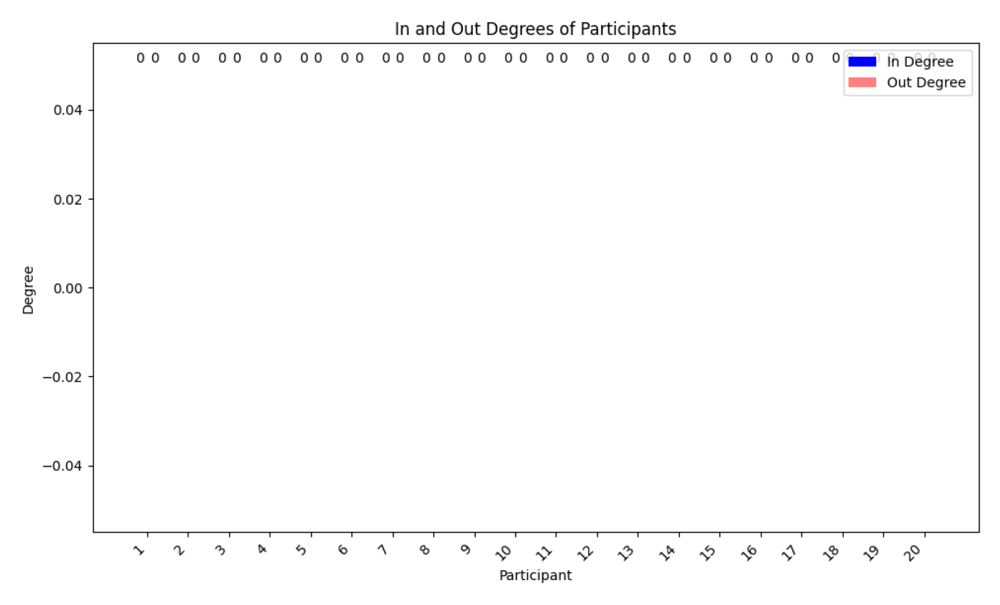

In [16]:
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
import numpy as np
from concurrent.futures import ThreadPoolExecutor
from PIL import Image
import time
import re


time_between_images = 350  # ms
png_counter = 96

# Function to load an image
def load_image(file_path):
    return np.array(Image.open(file_path))

# Get all PNG files in the directory starting from graph_1.png
image_files = [f"./video-cumulatief/graph_{i}.png" for i in range(1, png_counter)]

# Sort image files numerically
def sort_numerically(file_list):
    return sorted(file_list, key=lambda x: int(re.findall(r'\d+', x)[0]), reverse=False)  # reverse order

sorted_image_files = sort_numerically(image_files)

# Measure time for loading images
start_time = time.time()
with ThreadPoolExecutor() as executor:
    images = list(executor.map(load_image, sorted_image_files))
load_time = time.time() - start_time
print(f"Time to load {png_counter-1} images: {load_time:.2f} seconds")

# Set up a Full HD resolution figure
fig, ax = plt.subplots(figsize=(19.2, 10.8), dpi=100)  # 19.2 inches * 100 dpi = 1920 pixels, 10.8 inches * 100 dpi = 1080 pixels
ax.axis('off')

# Display the first image initially
im = ax.imshow(images[0])

def update(i):
    im.set_array(images[i])
    return [im]

# Set up the animation
ani = FuncAnimation(fig, update, frames=len(images), interval=time_between_images, blit=True)

# Measure time for creating animation
start_time = time.time()

# Save the animation
ani.save('graph_animation.mp4', writer='ffmpeg', dpi=100, fps=30, codec='libx264', extra_args=['-preset', 'ultrafast', '-crf', '18'])

save_time = time.time() - start_time
print(f"Time to save animation: {save_time:.2f} seconds")

print("Video has been created and saved as 'graph_animation.mp4'.")


In [3]:
from IPython.display import Video
Video('graph_animation.mp4', embed=True, width=1920, height=1080)

## Basic Analysis


In [32]:
#print basic network statistics
betw=g.betweenness()
print(betw)
degree=g.degree()
print(degree)
closeness=g.closeness()
print(closeness)
pagerank=g.pagerank()
print(pagerank)
avg_path=g.average_path_length()
print(avg_path)
clustering_coeff=g.transitivity_undirected()
print(clustering_coeff)

[0.25, 0.2222222222222222, 0.0, 0.0, 0.0, 0.0, 10.472222222222221, 8.88888888888889, 10.0, 0.0, 77.83333333333334, 0.0, 64.97222222222221, 0.25, 0.2222222222222222, 0.2222222222222222, 0.2222222222222222, 0.2222222222222222, 0.2222222222222222, 0.0]
[9, 9, 7, 7, 7, 7, 12, 13, 14, 10, 23, 5, 27, 9, 12, 12, 12, 12, 9, 6]
[0.5277777777777778, 0.59375, 0.48717948717948717, 0.48717948717948717, 0.48717948717948717, 0.48717948717948717, 0.6333333333333333, 0.6333333333333333, 0.6333333333333333, 0.59375, 0.7916666666666666, 0.5135135135135135, 0.8260869565217391, 0.5277777777777778, 0.6129032258064516, 0.6129032258064516, 0.6129032258064516, 0.6129032258064516, 0.59375, 0.59375]
[0.03603823979789986, 0.04092704178373438, 0.031451098195499676, 0.031451098195499676, 0.031451098195499676, 0.031451098195499676, 0.03920625125712741, 0.049243806017199396, 0.03518853471110625, 0.011401023095868632, 0.1187665752058856, 0.04216474056354282, 0.11156766357436088, 0.03603823979789986, 0.0657756028667159

### Degree Distribution

Text(0.5, 1.0, 'Degree distribution')

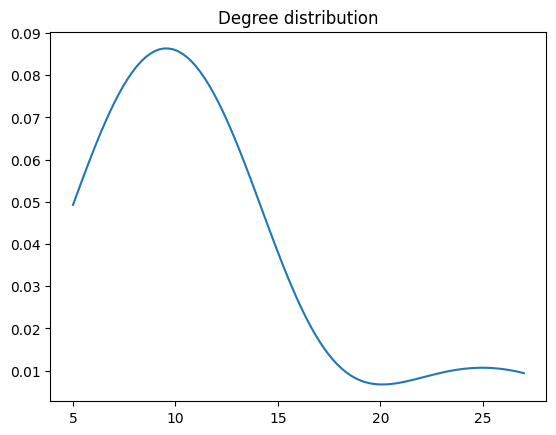

In [33]:
# Estimation of the probability denstity function using a kernel-density estimation using Gaussian kernel
kde = gaussian_kde(degree)
# these are the values over wich your kernel will be evaluated
dist_space = np.linspace( min(degree), max(degree), 100 )
# plot the results
plt.plot( dist_space, kde(dist_space) )
plt.title("Degree distribution")

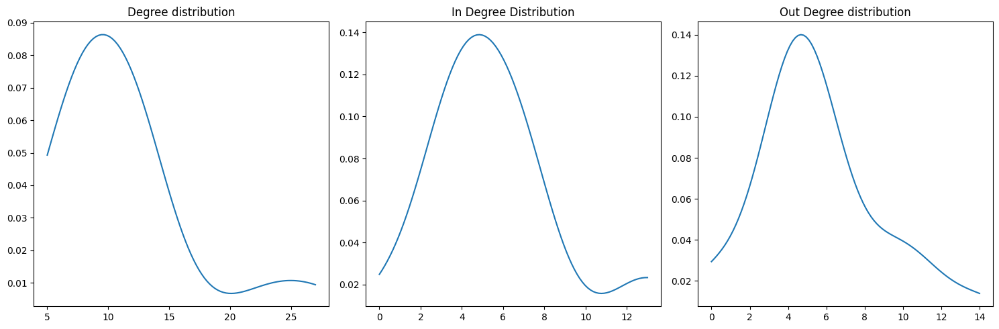

In [34]:
# Create a figure and subplots
fig, axes = plt.subplots(1, 3, figsize=(15, 5))  # 1 row, 3 columns

# Plot 1: Degree distribution
degree=g.degree()
kde = gaussian_kde(degree)
dist_space = np.linspace( min(degree), max(degree), 100 )
axes[0].plot(dist_space, kde(dist_space))
axes[0].set_title("Degree distribution")

# Plot 2: In degree distribution
in_degree=g.indegree()
kde = gaussian_kde(in_degree)
dist_space = np.linspace( min(in_degree), max(in_degree), 100 )
axes[1].plot(dist_space, kde(dist_space))
axes[1].set_title("In Degree Distribution")

# Plot 3: Out Degree distribution
out_degree=g.outdegree()
kde = gaussian_kde(out_degree)
dist_space = np.linspace( min(out_degree), max(out_degree), 100 )
axes[2].plot(dist_space, kde(dist_space))
axes[2].set_title("Out Degree distribution")

# Adjust layout
plt.tight_layout()

# Show the plot
plt.show()

### Betweenness Distribution

Text(0.5, 1.0, 'Betweenness distribution')

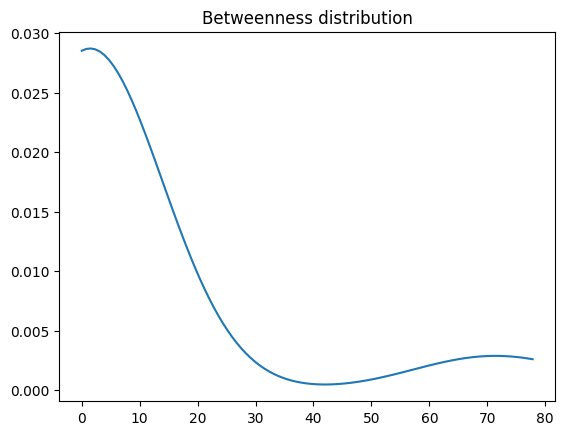

In [35]:
# Estimation of the probability denstity function using a kernel-density estimation using Gaussian kernel
btw=g.betweenness()
kde = gaussian_kde(btw)
# these are the values over wich your kernel will be evaluated
dist_space = np.linspace( min(btw), max(btw), 100 )
# plot the results
plt.plot( dist_space, kde(dist_space) )
plt.title("Betweenness distribution")

In [38]:
# Find nodes with the highest degree
max_degree_value = max(degree)
max_degree_nodes = [node for node, node_degree in enumerate(degree) if node_degree == max_degree_value]
max_degree_nodes_labels = [g.vs[node]["name"] for node in list(max_degree_nodes)]
max_degree_nodes_id = [g.vs[node]["name"] for node in list(max_degree_nodes)]


# Find nodes with the highest betweenness
max_betweenness_value = max(btw)
max_betweenness_nodes = [node for node, betweenness in enumerate(btw) if betweenness == max_betweenness_value]
max_betweenness_nodes_labels = [g.vs[node]["name"] for node in list(max_betweenness_nodes)]
max_betweenness_nodes_id = [g.vs[node]["name"] for node in list(max_betweenness_nodes)]


print(f"Nodes with the highest degree: {max_degree_nodes_labels} (Degree: {max_degree_value})")
print(f"Nodes with the highest betweenness: {max_betweenness_nodes_labels} (Betweenness: {max_betweenness_value})")

Nodes with the highest degree: ['20'] (Degree: 27)
Nodes with the highest betweenness: ['19'] (Betweenness: 77.83333333333334)


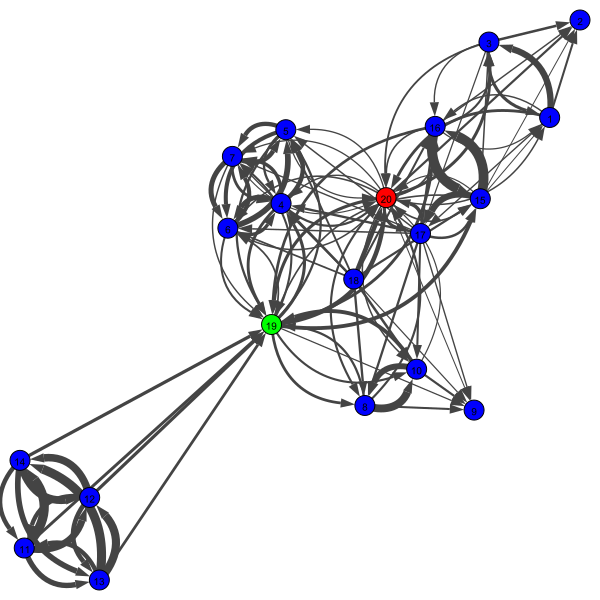

In [39]:
#visual with the nodes with the highest betweenness in yellow
# Normalize edge weights for visualization
weights = np.array(g.es["weight"])
normalized_weights = 1 + 9 * (weights - weights.min()) / (weights.max() - weights.min())
# Create plot using Fruchterman-Rheingold
layout_fr = g.layout("fr")

visual_style = {}
visual_style["vertex_size"] = 20
visual_style["vertex_label_size"]=10
visual_style["vertex_color"] = "blue"
visual_style["vertex_label"] = g.vs["name"]
visual_style["layout"] = layout_fr
visual_style["edge_width"]=normalized_weights
visual_style["bbox"] = (600, 600)
visual_style["margin"] = 20

#give a different colour to the nodes with the highest betweenness, and highest degree
g.vs['color']='blue'
for i in max_betweenness_nodes:
  g.vs[i]['color']='yellow'
for i in max_degree_nodes:
  g.vs[i]['color']='red'
for i in max_degree_nodes and max_betweenness_nodes:
  g.vs[i]['color']='green'

visual_style["vertex_color"] = g.vs['color']


ig.plot(g, **visual_style)

number of nodes removed: 1


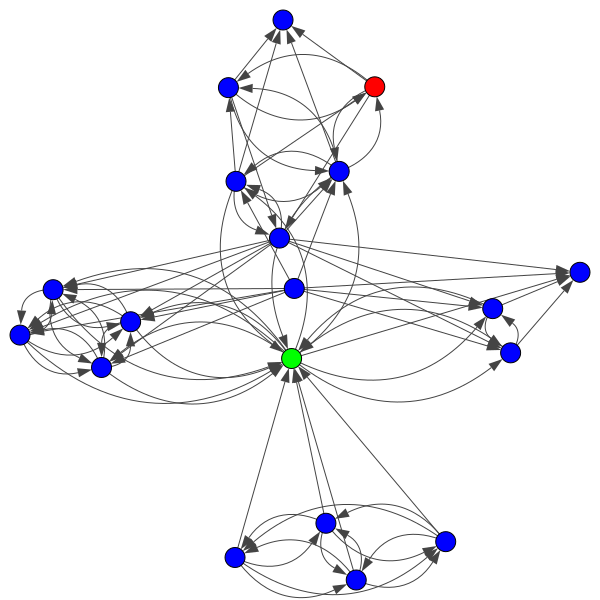

In [40]:
#run this cell to remove the nodes with the highest degree
#it takes a few iterations with deletion of nodes before the network starts to collapse

max_degree_nodes = [node for node, node_degree in enumerate(g.degree()) if node_degree == max(g.degree())]
g.delete_vertices(max_degree_nodes)
print("number of nodes removed:", len(max_degree_nodes))

weights = np.array(g.es["weight"])
normalized_weights = 1 + 9 * (weights - weights.min()) / (weights.max() - weights.min())
# Create plot using Fruchterman-Rheingold
layout_fr = g.layout("fr")

visual_style = {}
visual_style["vertex_size"] = 20
visual_style["vertex_label_size"]=10
visual_style["vertex_color"] = "blue"
visual_style["vertex_label"] = g.vs["name"]
visual_style["layout"] = layout_fr
visual_style["edge_width"]=normalized_weights
visual_style["bbox"] = (600, 600)
visual_style["margin"] = 20

#give a different colour to the nodes with the highest betweenness, and highest degree
g.vs['color']='blue'
for i in max_betweenness_nodes:
  g.vs[i]['color']='yellow'
for i in max_degree_nodes:
  g.vs[i]['color']='red'
for i in max_degree_nodes and max_betweenness_nodes:
  g.vs[i]['color']='green'

visual_style["vertex_color"] = g.vs['color']
ig.plot(g)

## Community Detection
